## Imports & matplotlib setup

In [17]:
from datasets import load_dataset
from PIL import Image
import random, requests
random.seed(42)
import matplotlib.pyplot as plt

# Make plots show inline in Jupyter
%matplotlib inline

In [2]:
import torch
import numpy as np
from sentence_transformers import SentenceTransformer

/home/hice1/vchopra37/scratch/projects/edge_glass/edge_glass_env/lib/python3.12/site-packages/transformers/utils/hub.py:110: FutureWarning: Using `TRANSFORMERS_CACHE` is deprecated and will be removed in v5 of Transformers. Use `HF_HOME` instead.
  warnings.warn(


In [ ]:
from transformers import CLIPModel, CLIPProcessor
from transformers import AutoModel, AutoTokenizer


In [4]:
from PIL import Image
import requests
from io import BytesIO

In [5]:
device = "cuda" if torch.cuda.is_available() else "cpu"
print("Using device:", device)

Using device: cuda


## Load the Dataset

In [ ]:
ds = load_dataset("allenai/pixmo-cap", streaming=True, split="train")

In [11]:
# Take 20 Samples
sample_ds = ds.take(20)
sample_ds = list(sample_ds)
sample_ds

[{'image_url': 'https://pixmo.s3.us-west-2.amazonaws.com/birds/1491.png',
  'caption': "This photograph depicts a striking black bird, possibly a grackle or similar species, perched on a white cement wall with red stains. The bird's sleek, elongated body is adorned with iridescent feathers that shimmer with shades of blue, purple, and green, most prominently on its wings and back. Its piercing yellow eye and long, sharp beak lend it a fierce, almost aerodynamic appearance. The bird's dark, slender legs and short talons grip the edge of the cement structure, which resembles a divider or barrier, possibly in an outdoor setting like a park or building patio. The background is a blur of green and white hues, hinting at lush tropical plants and tall trees, setting a serene, natural scene. The bird is poised, looking towards the upper right-hand corner of the frame, with its long tail feathers trailing elegantly to the left.",
  'transcripts': ["This is a picture of a long black bird with a 

dict_keys(['image_url', 'caption', 'transcripts'])
Image URL: https://i.redd.it/k26ssob6xot11.jpg


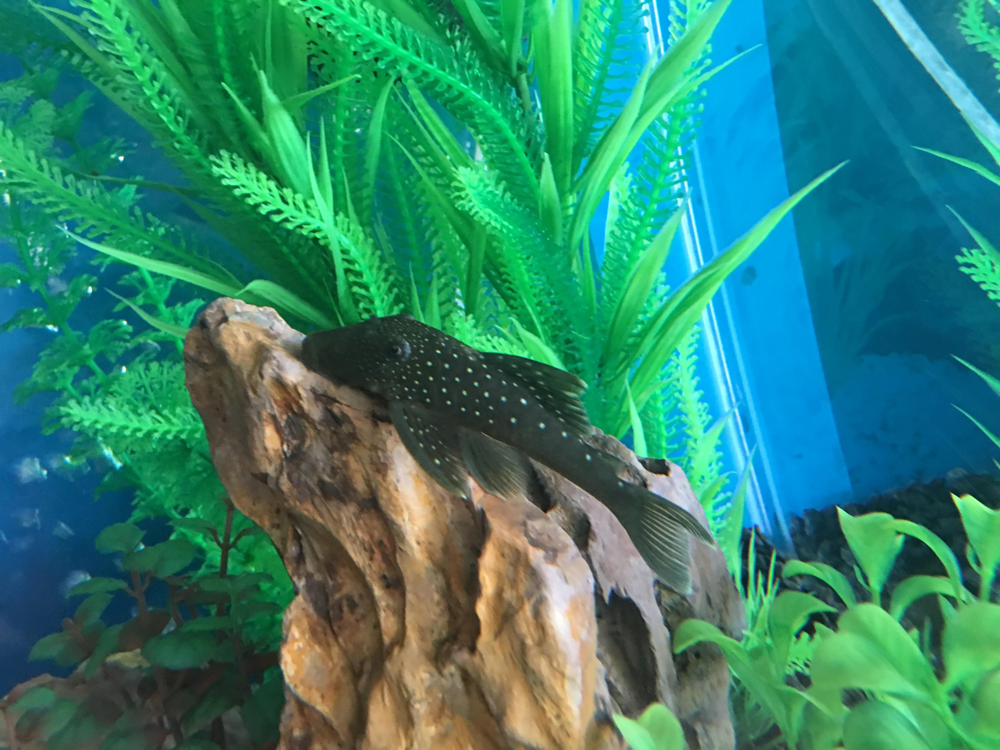

Caption: A large brown suckerfish, commonly known as a plecostomus or pleco catfish, is prominently displayed inside a home fish tank. This species, recognized for its sucker-like mouth, clings to various surfaces within the tank, feeding on algae and other nutritional debris. This natural cleaning behavior helps maintain the tank's cleanliness, making it a popular choice among aquarium enthusiasts. In the image, the suckerfish is currently affixed to a piece of driftwood. Surrounding it are artificial plants anchored at the base of the aquarium, which is lined with black rocks. The plecostomus, often seen in household aquariums, contributes to the pristine condition of the tank by continuously scouring the glass and other surfaces, ensuring a clean and healthy environment.


In [18]:
## Inspect one Sample
sample = sample_ds[random.randint(0, len(sample_ds)-1)]
print(sample.keys())
print("Image URL:", sample['image_url'])
display(Image.open(BytesIO(requests.get(sample['image_url']).content)))
print("Caption:", sample['caption'])

## 2. Text encoder: get comfortable with sentence embeddings

### 2.1 Load the encoder

In [ ]:
text_model_name = "sentence-transformers/all-MiniLM-L6-v2"
text_encoder = SentenceTransformer(text_model_name, device=device)

sentences = [
    "A dog is playing in the park.",
    "A man is giving a speech.",
    "A small airplane is flying in the sky."
]

text_emb = text_encoder.encode(sentences, convert_to_numpy=True, normalize_embeddings=True)
print("Shape:", text_emb.shape)   # (3, d)


### 2.2 Inspect similarities

Interpretation:

Diagonal ≈ 1

Off-diagonal entries show sentence similarity (“dog vs airplane” should be low).

💡 Takeaway: A text encoder is just a function list[str] → 2D array (n, d).

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity
sim_mat = cosine_similarity(text_emb, text_emb)
print(np.round(sim_mat, 2))

## Image–Text with CLIP

### Load a tiny image–caption dataset (allenai/pixmo-cap)

In [ ]:
from itertools import islice

ds = load_dataset("allenai/pixmo-cap", split="train[:5]")
len(ds)

In [ ]:
SAMPLE = ds[1]
SAMPLE

In [ ]:
response = requests.get(SAMPLE["image_url"])
print(SAMPLE["caption"])
print(response.status_code)
img = Image.open(BytesIO(response.content))
img


### Load CLIP encoder (image + text)

CLIP’s text encoder can only handle up to 77 tokens (this is hard-coded in the model). One (or more) of your captions becomes 366 tokens after tokenization.

In [ ]:
from transformers import CLIPModel, CLIPProcessor

clip_name = "openai/clip-vit-base-patch16"
clip_model = CLIPModel.from_pretrained(clip_name).to(device).eval()
clip_proc  = CLIPProcessor.from_pretrained(clip_name)


In [ ]:
images = []
captions = []
for sample in range(0,len(ds)):
   caption= ds[sample]["caption"].strip()
   response = requests.get(ds[sample]["image_url"])
   if response.status_code != 200:
       print(sample)
       continue
   else:
      image= Image.open(BytesIO(response.content))
      images.append(image)
      captions.append(caption)

In [ ]:
with torch.no_grad():
    inputs = clip_proc(
        text=captions,
        images=images,
        return_tensors="pt",
        padding=True,
        truncation=True,              # ✅ <--- this is the key
        max_length=77
    ).to(device)
    
    out = clip_model(**inputs)
    img_emb = out.image_embeds      # (N, d)
    txt_emb = out.text_embeds       # (N, d)

# normalize
img_emb = img_emb / img_emb.norm(dim=-1, keepdim=True)
txt_emb = txt_emb / txt_emb.norm(dim=-1, keepdim=True)

print("Image emb shape:", img_emb.shape)
print("Text emb shape:", txt_emb.shape)


### Image–Text retrieval with cosine similarity

In [ ]:
sims = txt_emb @ img_emb.T   # dot product == cosine (normalized)
sims = sims.cpu().numpy()

for i, cap in enumerate(captions):
    best_img_idx = sims[i].argmax()
    print(f"\nCaption {i}: {cap}")
    print(f"Best-matched image index: {best_img_idx}")

In [ ]:
import matplotlib.pyplot as plt

i = 0
plt.imshow(images[0])
plt.axis("off")
print("Caption:", captions[0])
